In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from PIL import Image
from torchvision import transforms
import matplotlib.pyplot as plt
from typing import Tuple
import torchvision.models as models
import torchvision.transforms as T
import numpy as np
import os

print("Cuda available :", torch.cuda.is_available())
print("cuda version : ", torch.backends.cudnn.version())
print("No of GPU : ", torch.cuda.device_count())
for i in range(torch.cuda.device_count()):
    print(f"Device {i} Name: ", torch.cuda.get_device_name(i))

Cuda available : True
cuda version :  8907
No of GPU :  1
Device 0 Name:  NVIDIA GeForce GTX 1650 with Max-Q Design


In [2]:
# Get image inputs and preprocess
def preprocess_images(image_path1: str, image_path2: str, height_width: int = 256) -> Tuple[torch.Tensor, torch.Tensor]:
    transform = transforms.Compose([
        transforms.Resize((height_width, height_width)),
        transforms.ToTensor()
    ])
    image1 = Image.open(image_path1).convert("RGB")
    image2 = Image.open(image_path2).convert("RGB")
    # print("Shape of Image 1: ", image1.size)
    # print("Shape of Image 2: ", image2.size)
    image1 = transform(image1)
    image2 = transform(image2)
    # print("Shape of Reshaped Image 1: ", image1.shape)
    # print("Shape of Reshaped Image 2: ", image2.shape)
    return image1, image2

def show_image(image: torch.Tensor) -> None:
    image_np = image.squeeze().detach().numpy()
    image_np = image_np.transpose(1, 2, 0)  # (C, H, W) -> (H, W, C)
    plt.imshow(image_np)
    plt.axis('off')

# Define a function to display an image on a given axis
def plot_image(ax, image: torch.Tensor, title: str):
    image_np = image.squeeze().detach().numpy()
    image_np = image_np.transpose(1, 2, 0)  # (C, H, W) -> (H, W, C)
    ax.imshow(image_np)
    ax.set_title(title)
    ax.axis('off')

image_path1 = './original_images/fuse1.JPEG'
image_path2 = './original_images/fuse2.JPEG'
img1, img2 = preprocess_images(image_path1, image_path2)

In [3]:
def calculate_mean_pixel_difference(image1: torch.Tensor, image2: torch.Tensor, absolute: bool = True) -> float:
    if image1.shape != image2.shape:
        raise ValueError("Error: Tensors must have the same shape.")
    difference = image1 - image2
    if absolute:
        mean_difference = torch.mean(torch.abs(difference))
    else:
        mean_difference = torch.mean(difference ** 2)
    return mean_difference.item()  

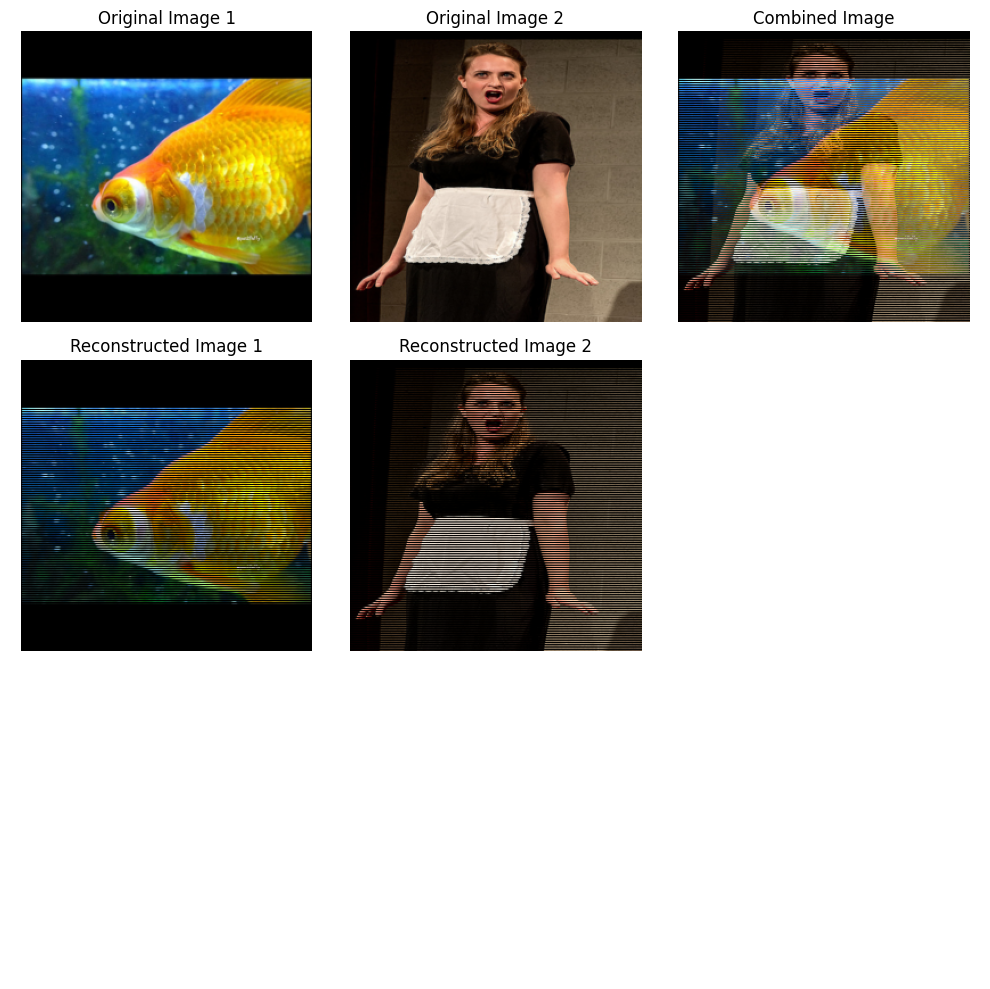

In [4]:
### ROW WISE Fusing

# Function to combine images pixel-wise
def combine_images_row_wise(img1: torch.Tensor, img2: torch.Tensor) -> torch.Tensor:
    combined_image_row_wise = torch.zeros_like(img1)
    combined_image_row_wise[:, ::2, :] = img1[:, ::2, :]
    combined_image_row_wise[:, 1::2, :] = img2[:, 1::2, :]
    return combined_image_row_wise

# Function to reconstruct images from combined image
def reconstruct_images_row_wise(combined_image_row_wise: torch.Tensor) -> Tuple[torch.Tensor, torch.Tensor]:
    img1_reconstructed_row_wise = torch.zeros_like(combined_image_row_wise)
    img2_reconstructed_row_wise = torch.zeros_like(combined_image_row_wise)
    img1_reconstructed_row_wise[:, ::2, :] = combined_image_row_wise[:, ::2, :]
    img2_reconstructed_row_wise[:, 1::2, :] = combined_image_row_wise[:, 1::2, :]
    return img1_reconstructed_row_wise, img2_reconstructed_row_wise


combined_image_row_wise = combine_images_row_wise(img1, img2)
img1_reconstructed_row_wise, img2_reconstructed_row_wise = reconstruct_images_row_wise(combined_image_row_wise)

fig, axes = plt.subplots(3, 3, figsize=(10, 10))
plot_image(axes[0][0], img1, "Original Image 1")
plot_image(axes[0][1], img2, "Original Image 2")
plot_image(axes[0][2], combined_image_row_wise, "Combined Image")
plot_image(axes[1][0], img1_reconstructed_row_wise, "Reconstructed Image 1")
plot_image(axes[1][1], img2_reconstructed_row_wise, "Reconstructed Image 2")
for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  
plt.tight_layout()
plt.show()

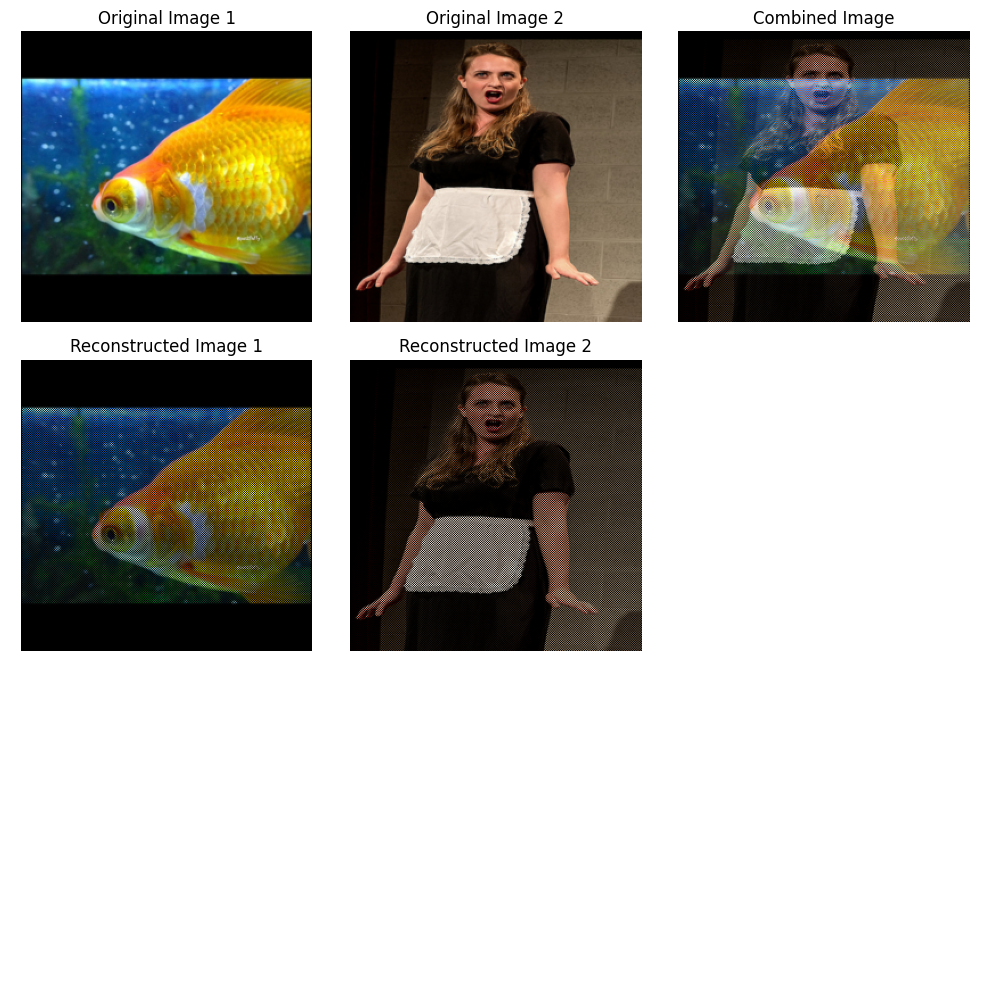

In [5]:
### PIXEL WISE Fusing

# Function to combine images pixel-wise with alternating pattern
def combine_images_pixel_wise(img1: torch.Tensor, img2: torch.Tensor) -> torch.Tensor:
    combined_image_pixel_wise = torch.zeros_like(img1)
    combined_image_pixel_wise[:, 0::2, ::2] = img1[:, 0::2, ::2]    # img1 even rows, even cols
    combined_image_pixel_wise[:, 0::2, 1::2] = img2[:, 0::2, 1::2]  # img2 even rows, odd cols
    combined_image_pixel_wise[:, 1::2, ::2] = img2[:, 1::2, ::2]    # img2 odd rows, even cols
    combined_image_pixel_wise[:, 1::2, 1::2] = img1[:, 1::2, 1::2]  # img1 odd rows, odd cols
    return combined_image_pixel_wise

# Function to reconstruct images from combined image
def reconstruct_images_pixel_wise(combined_image_pixel_wise: torch.Tensor) -> Tuple[torch.Tensor, torch.Tensor]:
    img1_reconstructed_pixel_wise = torch.zeros_like(combined_image_pixel_wise)
    img2_reconstructed_pixel_wise = torch.zeros_like(combined_image_pixel_wise)
    img1_reconstructed_pixel_wise[:, 0::2, ::2] = combined_image_pixel_wise[:, 0::2, ::2]
    img2_reconstructed_pixel_wise[:, 0::2, 1::2] = combined_image_pixel_wise[:, 0::2, 1::2]
    img2_reconstructed_pixel_wise[:, 1::2, ::2] = combined_image_pixel_wise[:, 1::2, ::2]
    img1_reconstructed_pixel_wise[:, 1::2, 1::2] = combined_image_pixel_wise[:, 1::2, 1::2]
    return img1_reconstructed_pixel_wise, img2_reconstructed_pixel_wise


combined_image_pixel_wise = combine_images_pixel_wise(img1, img2)
img1_reconstructed_pixel_wise, img2_reconstructed_pixel_wise = reconstruct_images_pixel_wise(combined_image_pixel_wise)

fig, axes = plt.subplots(3, 3, figsize=(10, 10))
plot_image(axes[0][0], img1, "Original Image 1")
plot_image(axes[0][1], img2, "Original Image 2")
plot_image(axes[0][2], combined_image_pixel_wise, "Combined Image")
plot_image(axes[1][0], img1_reconstructed_pixel_wise, "Reconstructed Image 1")
plot_image(axes[1][1], img2_reconstructed_pixel_wise, "Reconstructed Image 2")
for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  
plt.tight_layout()
plt.show()

In [6]:
# Refinement functions

# Function to apply Gaussian smoothing - TESTED
def apply_gaussian_smoothing(image: torch.Tensor, kernel_size: int = 3, sigma: float = 1.0) -> torch.Tensor:
    gaussian_blur = T.GaussianBlur(kernel_size=kernel_size, sigma=sigma)
    smoothed_image = gaussian_blur(image)
    return smoothed_image

# Function to apply Bilinear Interpolation - TESTED
def apply_bilinear_interpolation(image: torch.Tensor, scale_factor: float = 1.0) -> torch.Tensor:
    if scale_factor != 1.0:
        image = F.interpolate(image.unsqueeze(0), scale_factor=scale_factor, mode='bilinear', align_corners=True)
        image = F.interpolate(image, size=(256, 256), mode='bilinear', align_corners=True)  
        return image.squeeze(0)  
    return image

#bicubid interpollation - TESTED
def apply_bicubic_interpolation(image: torch.Tensor, scale_factor: float = 1.0, target_size: Tuple[int, int] = None) -> torch.Tensor:
    image = image.unsqueeze(0) 
    if target_size is not None:
        resized_image = F.interpolate(image, size=target_size, mode='bicubic', align_corners=True)
    else:
        resized_image = F.interpolate(image, scale_factor=scale_factor, mode='bicubic', align_corners=True)
    return resized_image.squeeze(0)  

# Function to apply Median Filtering
def apply_median_filtering(image: torch.Tensor, kernel_size: int = 3) -> torch.Tensor:
    image = image.unsqueeze(0) 
    median_filtered_image = F.median_blur(image, kernel_size=kernel_size)
    return median_filtered_image.squeeze(0)  

# def apply_median_filtering(image: torch.Tensor, kernel_size: int = 3) -> torch.Tensor:
#     image_np = image.permute(1, 2, 0).cpu().numpy()
#     median_filtered_np = np.stack([cv2.medianBlur(image_np[:, :, i], kernel_size) for i in range(image_np.shape[2])], axis=2)
#     median_filtered_image = torch.from_numpy(median_filtered_np).permute(2, 0, 1)
#     return median_filtered_image.to(image.device)

# Function to apply Laplacian Sharpening
def apply_laplacian_sharpening(image: torch.Tensor) -> torch.Tensor:
    laplacian_kernel = torch.tensor([[0, -1, 0],
                                     [-1, 4, -1],
                                     [0, -1, 0]]).float().unsqueeze(0).unsqueeze(0)
    laplacian_kernel = laplacian_kernel.to(image.device)  
    channels = []
    for c in range(image.size(0)):
        channel = image[c:c+1].unsqueeze(0)  
        channel_filtered = F.conv2d(channel, laplacian_kernel, padding=1)
        channels.append(channel_filtered)
    sharpened_image = torch.cat(channels, dim=1).squeeze(0)  
    sharpened_image = torch.clamp(image + sharpened_image, 0, 1)
    return sharpened_image

# Function to apply Super-Resolution (Using a Pre-Trained Model)
def apply_super_resolution(image: torch.Tensor, upscale_factor: int = 2) -> torch.Tensor:
    model = models.srresnet(pretrained=True)
    model.eval()  
    with torch.no_grad():
        image_upscaled = model(image.unsqueeze(0))
    return image_upscaled.squeeze(0)  

# Function to adjust the brightness of an image
def adjust_brightness(image: torch.Tensor, brightness_factor: float) -> torch.Tensor:
    brightened_image = torch.clamp(image * brightness_factor, 0, 1)
    return brightened_image

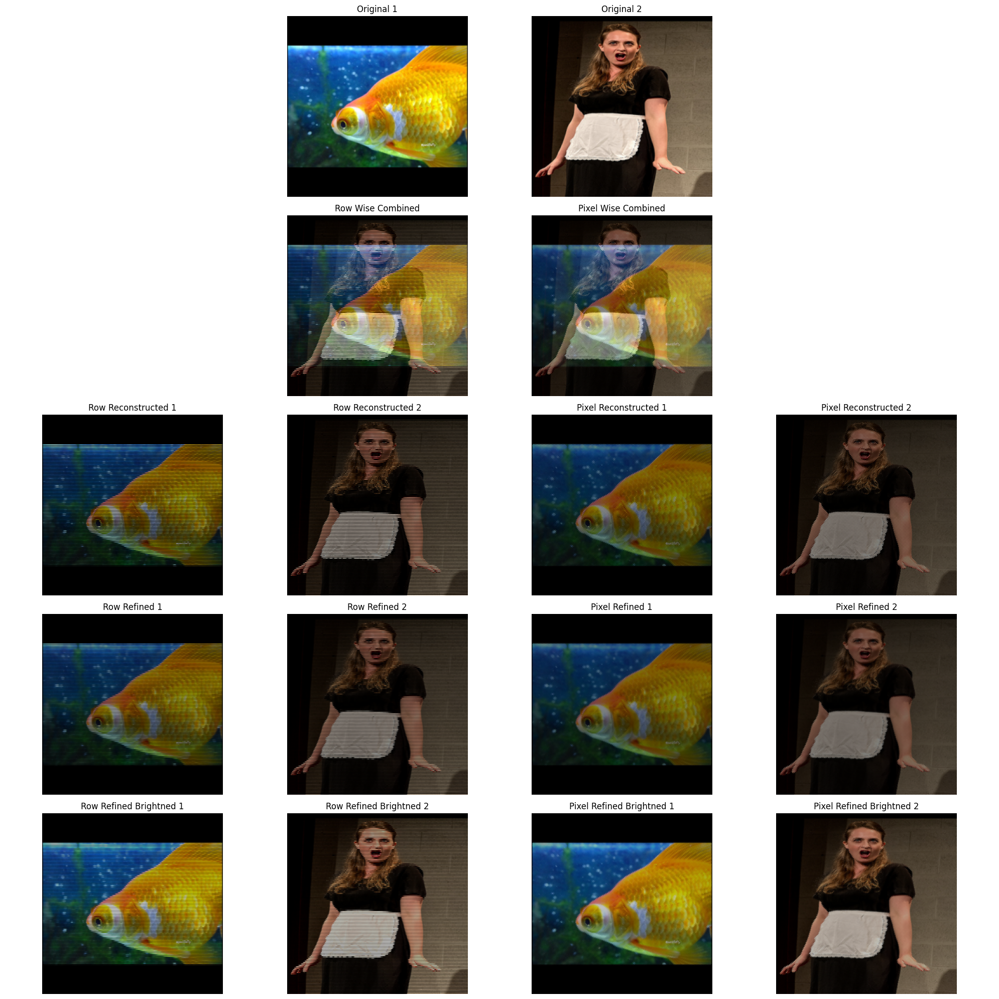

In [7]:
# Apply Bilinear interpollation to the reconstructed images

brightness_factor=1.5
img1_reconstructed_row_wise_bilinear_interpolation = apply_bilinear_interpolation(img1_reconstructed_row_wise, scale_factor=2.0)
img2_reconstructed_row_wise_bilinear_interpolation = apply_bilinear_interpolation(img2_reconstructed_row_wise, scale_factor=2.0)
img1_reconstructed_pixel_wise_bilinear_interpolation = apply_bilinear_interpolation(img1_reconstructed_pixel_wise, scale_factor=2.0)
img2_reconstructed_pixel_wise_bilinear_interpolation = apply_bilinear_interpolation(img2_reconstructed_pixel_wise, scale_factor=2.0)
img1_reconstructed_row_wise_bilinear_interpolation_brightned = adjust_brightness(apply_bilinear_interpolation(img1_reconstructed_row_wise, scale_factor=2.0),brightness_factor)
img2_reconstructed_row_wise_bilinear_interpolation_brightned = adjust_brightness(apply_bilinear_interpolation(img2_reconstructed_row_wise, scale_factor=2.0),brightness_factor)
img1_reconstructed_pixel_wise_bilinear_interpolation_brightned = adjust_brightness(apply_bilinear_interpolation(img1_reconstructed_pixel_wise, scale_factor=2.0),brightness_factor)
img2_reconstructed_pixel_wise_bilinear_interpolation_brightned = adjust_brightness(apply_bilinear_interpolation(img2_reconstructed_pixel_wise, scale_factor=2.0),brightness_factor)

# Plot images in a row
fig, axes = plt.subplots(5, 4, figsize=(20,20))

# Plot each image with its title
plot_image(axes[0][1], img1, "Original 1")
plot_image(axes[0][2], img2, "Original 2")
plot_image(axes[1][1], combined_image_row_wise, "Row Wise Combined")
plot_image(axes[1][2], combined_image_pixel_wise, "Pixel Wise Combined")

plot_image(axes[2][0], img1_reconstructed_row_wise, "Row Reconstructed 1")
plot_image(axes[2][1], img2_reconstructed_row_wise, "Row Reconstructed 2")
plot_image(axes[2][2], img1_reconstructed_pixel_wise, "Pixel Reconstructed 1")
plot_image(axes[2][3], img2_reconstructed_pixel_wise, "Pixel Reconstructed 2")

plot_image(axes[3][0], img1_reconstructed_row_wise_bilinear_interpolation, "Row Refined 1")
plot_image(axes[3][1], img2_reconstructed_row_wise_bilinear_interpolation, "Row Refined 2")
plot_image(axes[3][2], img1_reconstructed_pixel_wise_bilinear_interpolation, "Pixel Refined 1")
plot_image(axes[3][3], img2_reconstructed_pixel_wise_bilinear_interpolation, "Pixel Refined 2")

plot_image(axes[4][0], img1_reconstructed_row_wise_bilinear_interpolation_brightned, "Row Refined Brightned 1")
plot_image(axes[4][1], img2_reconstructed_row_wise_bilinear_interpolation_brightned, "Row Refined Brightned 2")
plot_image(axes[4][2], img1_reconstructed_pixel_wise_bilinear_interpolation_brightned, "Pixel Refined Brightned 1")
plot_image(axes[4][3], img2_reconstructed_pixel_wise_bilinear_interpolation_brightned, "Pixel Refined Brightned 2")

for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  
plt.tight_layout()
plt.show()

In [8]:
print("Bilinear Interpolation Refinement")
pixel_diff_bilinear_1 = calculate_mean_pixel_difference(img1, img1_reconstructed_pixel_wise_bilinear_interpolation, absolute=False)
print("Pixel Differences Tensor of image 1:", pixel_diff_bilinear_1)
absolute_diff_bilinear_1 = calculate_mean_pixel_difference(img1, img1_reconstructed_pixel_wise_bilinear_interpolation, absolute=True)
print("Absolute Pixel Differences Tensor of image 1:", absolute_diff_bilinear_1)
pixel_diff_bilinear_2 = calculate_mean_pixel_difference(img2, img2_reconstructed_pixel_wise_bilinear_interpolation, absolute=False)
print("Pixel Differences Tensor of image 2:", pixel_diff_bilinear_2)
absolute_diff_bilinear_2 = calculate_mean_pixel_difference(img2, img2_reconstructed_pixel_wise_bilinear_interpolation, absolute=True)
print("Absolute Pixel Differences Tensor of image 2:", absolute_diff_bilinear_2)

Bilinear Interpolation Refinement
Pixel Differences Tensor of image 1: 0.048441652208566666
Absolute Pixel Differences Tensor of image 1: 0.13529177010059357
Pixel Differences Tensor of image 2: 0.04468545317649841
Absolute Pixel Differences Tensor of image 2: 0.13864390552043915


Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.072247766..0.98071307].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.098299876..0.98549277].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.006687823..0.9861271].
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-0.014121603..0.9656822].


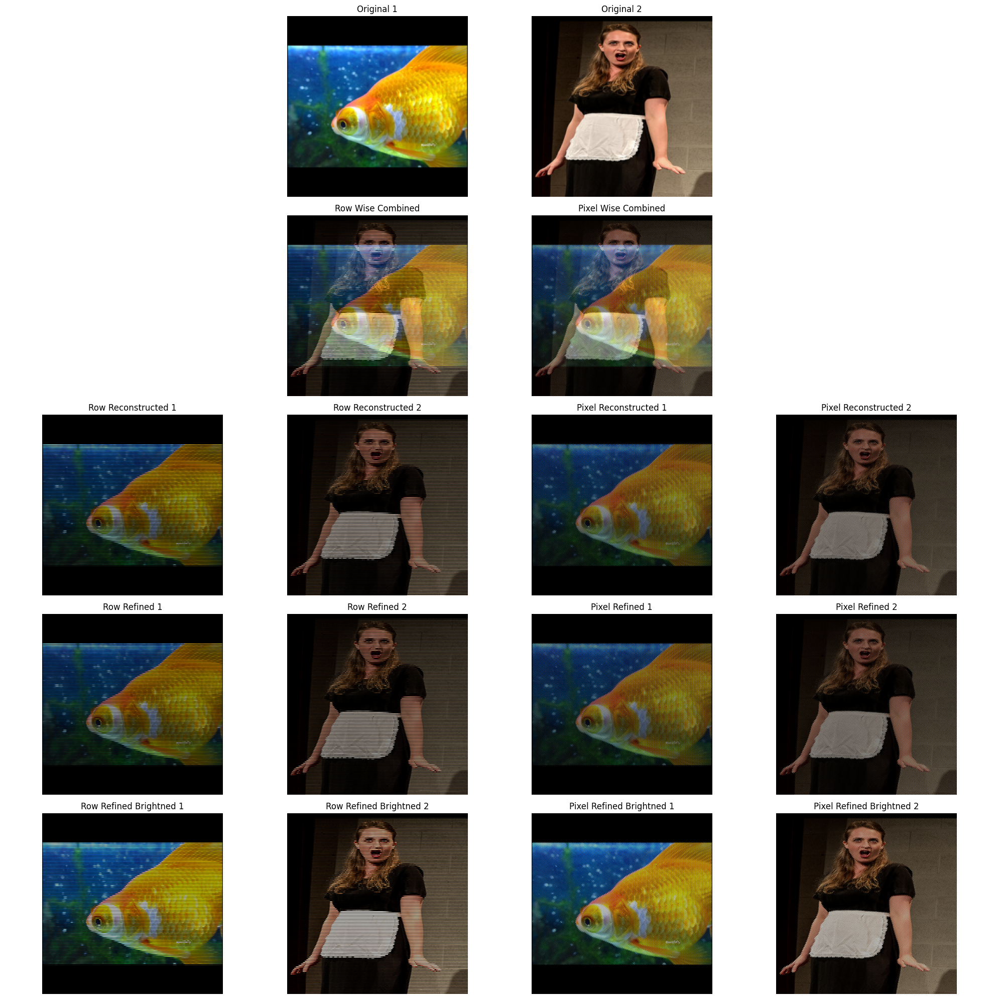

In [9]:
# Apply Bicubic interpollation to the reconstructed images

brightness_factor=1.5
img1_reconstructed_row_wise_bicubic_interpolation = apply_bicubic_interpolation(img1_reconstructed_row_wise, scale_factor=2.0)
img2_reconstructed_row_wise_bicubic_interpolation = apply_bicubic_interpolation(img2_reconstructed_row_wise, scale_factor=2.0)
img1_reconstructed_pixel_wise_bicubic_interpolation = apply_bicubic_interpolation(img1_reconstructed_pixel_wise, scale_factor=2.0)
img2_reconstructed_pixel_wise_bicubic_interpolation = apply_bicubic_interpolation(img2_reconstructed_pixel_wise, scale_factor=2.0)

# Resize the bicubic interpolated images back to original size
target_size = (256, 256)
img1_reconstructed_pixel_wise_bicubic_interpolation = F.interpolate(img1_reconstructed_pixel_wise_bicubic_interpolation.unsqueeze(0), size=target_size, mode='bicubic', align_corners=True).squeeze(0)
img2_reconstructed_pixel_wise_bicubic_interpolation = F.interpolate(img2_reconstructed_pixel_wise_bicubic_interpolation.unsqueeze(0), size=target_size, mode='bicubic', align_corners=True).squeeze(0)

img1_reconstructed_row_wise_bicubic_interpolation_brightned = adjust_brightness(apply_bicubic_interpolation(img1_reconstructed_row_wise, scale_factor=2.0),brightness_factor)
img2_reconstructed_row_wise_bicubic_interpolation_brightned = adjust_brightness(apply_bicubic_interpolation(img2_reconstructed_row_wise, scale_factor=2.0),brightness_factor)
img1_reconstructed_pixel_wise_bicubic_interpolation_brightned = adjust_brightness(apply_bicubic_interpolation(img1_reconstructed_pixel_wise, scale_factor=2.0),brightness_factor)
img2_reconstructed_pixel_wise_bicubic_interpolation_brightned = adjust_brightness(apply_bicubic_interpolation(img2_reconstructed_pixel_wise, scale_factor=2.0),brightness_factor)

# Plot images in a row
fig, axes = plt.subplots(5, 4, figsize=(20,20))

# Plot each image with its title
plot_image(axes[0][1], img1, "Original 1")
plot_image(axes[0][2], img2, "Original 2")
plot_image(axes[1][1], combined_image_row_wise, "Row Wise Combined")
plot_image(axes[1][2], combined_image_pixel_wise, "Pixel Wise Combined")

plot_image(axes[2][0], img1_reconstructed_row_wise, "Row Reconstructed 1")
plot_image(axes[2][1], img2_reconstructed_row_wise, "Row Reconstructed 2")
plot_image(axes[2][2], img1_reconstructed_pixel_wise, "Pixel Reconstructed 1")
plot_image(axes[2][3], img2_reconstructed_pixel_wise, "Pixel Reconstructed 2")

plot_image(axes[3][0], img1_reconstructed_row_wise_bicubic_interpolation, "Row Refined 1")
plot_image(axes[3][1], img2_reconstructed_row_wise_bicubic_interpolation, "Row Refined 2")
plot_image(axes[3][2], img1_reconstructed_pixel_wise_bicubic_interpolation, "Pixel Refined 1")
plot_image(axes[3][3], img2_reconstructed_pixel_wise_bicubic_interpolation, "Pixel Refined 2")

plot_image(axes[4][0], img1_reconstructed_row_wise_bicubic_interpolation_brightned, "Row Refined Brightned 1")
plot_image(axes[4][1], img2_reconstructed_row_wise_bicubic_interpolation_brightned, "Row Refined Brightned 2")
plot_image(axes[4][2], img1_reconstructed_pixel_wise_bicubic_interpolation_brightned, "Pixel Refined Brightned 1")
plot_image(axes[4][3], img2_reconstructed_pixel_wise_bicubic_interpolation_brightned, "Pixel Refined Brightned 2")

for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  
plt.tight_layout()
plt.show()

In [10]:
print("Bicubic Interpolation Refinement")
pixel_diff_bicubic_1 = calculate_mean_pixel_difference(img1, img1_reconstructed_pixel_wise_bicubic_interpolation, absolute=False)
print("Pixel Differences Tensor of image 1:", pixel_diff_bicubic_1)
absolute_diff_bicubic_1 = calculate_mean_pixel_difference(img1, img1_reconstructed_pixel_wise_bicubic_interpolation, absolute=True)
print("Absolute Pixel Differences Tensor of image 1:", absolute_diff_bicubic_1)
pixel_diff_bicubic_2 = calculate_mean_pixel_difference(img2, img2_reconstructed_pixel_wise_bicubic_interpolation, absolute=False)
print("Pixel Differences Tensor of image 2:", pixel_diff_bicubic_2)
absolute_diff_bicubic_2 = calculate_mean_pixel_difference(img2, img2_reconstructed_pixel_wise_bicubic_interpolation, absolute=True)
print("Absolute Pixel Differences Tensor of image 2:", absolute_diff_bicubic_2)

Bicubic Interpolation Refinement
Pixel Differences Tensor of image 1: 0.07857251912355423
Absolute Pixel Differences Tensor of image 1: 0.13526706397533417
Pixel Differences Tensor of image 2: 0.07147210836410522
Absolute Pixel Differences Tensor of image 2: 0.1385665237903595


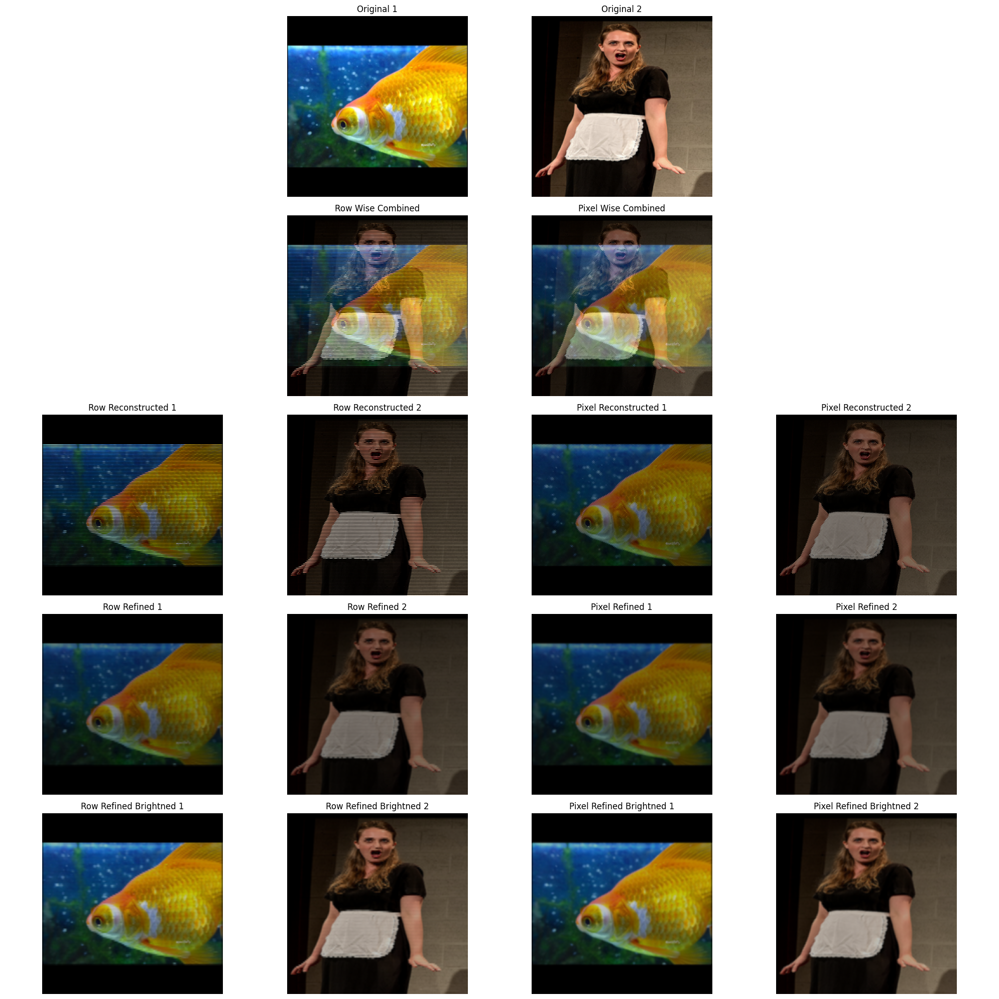

In [11]:
# Apply Gaussian Smoothig to the reconstructed images

brightness_factor=1.5
img1_reconstructed_row_wise_gaussian_smoothing = apply_gaussian_smoothing(img1_reconstructed_row_wise, kernel_size=3)
img2_reconstructed_row_wise_gaussian_smoothing = apply_gaussian_smoothing(img2_reconstructed_row_wise, kernel_size=3)
img1_reconstructed_pixel_wise_gaussian_smoothing = apply_gaussian_smoothing(img1_reconstructed_pixel_wise, kernel_size=3)
img2_reconstructed_pixel_wise_gaussian_smoothing = apply_gaussian_smoothing(img2_reconstructed_pixel_wise, kernel_size=3)
img1_reconstructed_row_wise_gaussian_smoothing_brightned = adjust_brightness(apply_gaussian_smoothing(img1_reconstructed_row_wise, kernel_size=3),brightness_factor)
img2_reconstructed_row_wise_gaussian_smoothing_brightned = adjust_brightness(apply_gaussian_smoothing(img2_reconstructed_row_wise, kernel_size=3),brightness_factor)
img1_reconstructed_pixel_wise_gaussian_smoothing_brightned = adjust_brightness(apply_gaussian_smoothing(img1_reconstructed_pixel_wise, kernel_size=3),brightness_factor)
img2_reconstructed_pixel_wise_gaussian_smoothing_brightned = adjust_brightness(apply_gaussian_smoothing(img2_reconstructed_pixel_wise, kernel_size=3),brightness_factor)

# Plot images in a row
fig, axes = plt.subplots(5, 4, figsize=(20,20))

# Plot each image with its title
plot_image(axes[0][1], img1, "Original 1")
plot_image(axes[0][2], img2, "Original 2")
plot_image(axes[1][1], combined_image_row_wise, "Row Wise Combined")
plot_image(axes[1][2], combined_image_pixel_wise, "Pixel Wise Combined")

plot_image(axes[2][0], img1_reconstructed_row_wise, "Row Reconstructed 1")
plot_image(axes[2][1], img2_reconstructed_row_wise, "Row Reconstructed 2")
plot_image(axes[2][2], img1_reconstructed_pixel_wise, "Pixel Reconstructed 1")
plot_image(axes[2][3], img2_reconstructed_pixel_wise, "Pixel Reconstructed 2")

plot_image(axes[3][0], img1_reconstructed_row_wise_gaussian_smoothing, "Row Refined 1")
plot_image(axes[3][1], img2_reconstructed_row_wise_gaussian_smoothing, "Row Refined 2")
plot_image(axes[3][2], img1_reconstructed_pixel_wise_gaussian_smoothing, "Pixel Refined 1")
plot_image(axes[3][3], img2_reconstructed_pixel_wise_gaussian_smoothing, "Pixel Refined 2")

plot_image(axes[4][0], img1_reconstructed_row_wise_gaussian_smoothing_brightned, "Row Refined Brightned 1")
plot_image(axes[4][1], img2_reconstructed_row_wise_gaussian_smoothing_brightned, "Row Refined Brightned 2")
plot_image(axes[4][2], img1_reconstructed_pixel_wise_gaussian_smoothing_brightned, "Pixel Refined Brightned 1")
plot_image(axes[4][3], img2_reconstructed_pixel_wise_gaussian_smoothing_brightned, "Pixel Refined Brightned 2")

for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  
plt.tight_layout()
plt.show()

In [12]:
print("Gaussian Smoothing Refinement")
pixel_diff_gaussian_1 = calculate_mean_pixel_difference(img1, img1_reconstructed_pixel_wise_gaussian_smoothing, absolute=False)
print("Pixel Differences Tensor of image 1:", pixel_diff_gaussian_1)
absolute_diff_gaussian_1 = calculate_mean_pixel_difference(img1, img1_reconstructed_pixel_wise_gaussian_smoothing, absolute=True)
print("Absolute Pixel Differences Tensor of image 1:", absolute_diff_gaussian_1)
pixel_diff_gaussian_2 = calculate_mean_pixel_difference(img2, img2_reconstructed_pixel_wise_gaussian_smoothing, absolute=False)
print("Pixel Differences Tensor of image 2:", pixel_diff_gaussian_2)
absolute_diff_gaussian_2 = calculate_mean_pixel_difference(img2, img2_reconstructed_pixel_wise_gaussian_smoothing, absolute=True)
print("Absolute Pixel Differences Tensor of image 2:", absolute_diff_gaussian_2)

Gaussian Smoothing Refinement
Pixel Differences Tensor of image 1: 0.0427376814186573
Absolute Pixel Differences Tensor of image 1: 0.13578471541404724
Pixel Differences Tensor of image 2: 0.03898328170180321
Absolute Pixel Differences Tensor of image 2: 0.13916362822055817


In [13]:
# 4NN Refinement
def replace_missing_pixels_with_neighbors(image_tensor: torch.Tensor, secret_image_number: int) -> torch.Tensor:
    channels, height, width = image_tensor.shape
    filled_image = image_tensor.clone()
    for i in range(height):
        for j in range(width):
            if secret_image_number == 1:
                if (i % 2 == 0 and j % 2 == 0) or (i % 2 == 1 and j % 2 == 1):
                    continue  
            elif secret_image_number == 2:
                if (i % 2 == 0 and j % 2 == 1) or (i % 2 == 1 and j % 2 == 0):
                    continue  
            if torch.all(filled_image[:, i, j] == 0):
                neighbors = []
                if i - 1 >= 0 and torch.any(filled_image[:, i - 1, j] != 0):
                    neighbors.append(filled_image[:, i - 1, j])
                if i + 1 < height and torch.any(filled_image[:, i + 1, j] != 0):
                    neighbors.append(filled_image[:, i + 1, j])
                if j - 1 >= 0 and torch.any(filled_image[:, i, j - 1] != 0):
                    neighbors.append(filled_image[:, i, j - 1])
                if j + 1 < width and torch.any(filled_image[:, i, j + 1] != 0):
                    neighbors.append(filled_image[:, i, j + 1])
                if neighbors:
                    filled_image[:, i, j] = torch.mean(torch.stack(neighbors), dim=0)
    return filled_image

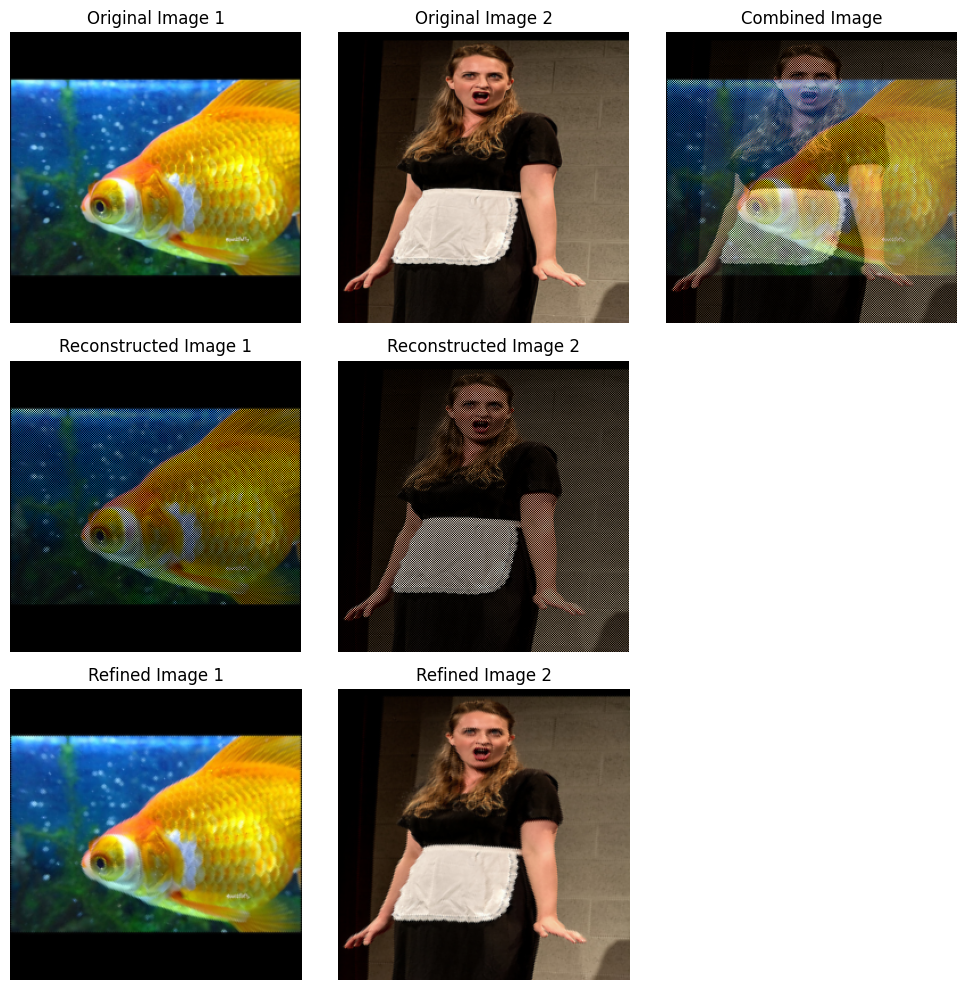

In [14]:
img1_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img1_reconstructed_pixel_wise, 1)
img2_NN_refined_pixel_wise = replace_missing_pixels_with_neighbors(img2_reconstructed_pixel_wise, 2)

fig, axes = plt.subplots(3, 3, figsize=(10, 10))
plot_image(axes[0][0], img1, "Original Image 1")
plot_image(axes[0][1], img2, "Original Image 2")
plot_image(axes[0][2], combined_image_pixel_wise, "Combined Image")
plot_image(axes[1][0], img1_reconstructed_pixel_wise, "Reconstructed Image 1")
plot_image(axes[1][1], img2_reconstructed_pixel_wise, "Reconstructed Image 2")
plot_image(axes[2][0], img1_NN_refined_pixel_wise, "Refined Image 1")
plot_image(axes[2][1], img2_NN_refined_pixel_wise, "Refined Image 2")

for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  
plt.tight_layout()
plt.show()

In [15]:
print("4 Nearest Neighbor Refinement")
pixel_diff_4nn_1 = calculate_mean_pixel_difference(img1, img1_NN_refined_pixel_wise, absolute=False)
print("Pixel Differences Tensor of image 1:", pixel_diff_4nn_1)
absolute_diff_4nn_1 = calculate_mean_pixel_difference(img1, img1_NN_refined_pixel_wise, absolute=True)
print("Absolute Pixel Differences Tensor of image 1:", absolute_diff_4nn_1)
pixel_diff_4nn_2 = calculate_mean_pixel_difference(img2, img2_NN_refined_pixel_wise, absolute=False)
print("Pixel Differences Tensor of image 2:", pixel_diff_4nn_2)
absolute_diff_4nn_2 = calculate_mean_pixel_difference(img2, img2_NN_refined_pixel_wise, absolute=True)
print("Absolute Pixel Differences Tensor of image 2:", absolute_diff_4nn_2)

4 Nearest Neighbor Refinement
Pixel Differences Tensor of image 1: 0.00017931737238541245
Absolute Pixel Differences Tensor of image 1: 0.0043012830428779125
Pixel Differences Tensor of image 2: 0.0003191778378095478
Absolute Pixel Differences Tensor of image 2: 0.005932027008384466


In [16]:
### PIXEL WISE WITH MSB TECHNIQUE

# Function to load and preprocess images
def load_image_msb(image_path: str, size=(256, 256)) -> torch.Tensor:
    image = Image.open(image_path).convert("RGB")  
    transform = transforms.Compose([
        transforms.Resize(size),
        transforms.ToTensor(),  
    ])
    image_tensor = transform(image) * 255  
    return image_tensor.to(torch.uint8)

# Function to display an image
def plot_image_msb(ax, image: torch.Tensor, title: str):
    image_np = image.permute(1, 2, 0).byte().numpy()  
    ax.imshow(image_np)
    ax.set_title(title)
    ax.axis('off')  

# Combining images using MSB
def combine_images_pixel_wise_msb(img1: torch.Tensor, img2: torch.Tensor) -> torch.Tensor:
    img1 = img1.to(torch.uint8)
    img2 = img2.to(torch.uint8)
    combined_image_pixel_wise = torch.zeros_like(img1)
    img1_msb = img1 & 0xF0  
    img2_msb = img2 & 0xF0 
    combined_image_pixel_wise[:, ::2, ::2] = (img1_msb[:, ::2, ::2] | (img2_msb[:, ::2, ::2] >> 4))      # even row, even col
    combined_image_pixel_wise[:, ::2, 1::2] = (img2_msb[:, ::2, 1::2] | (img1_msb[:, ::2, 1::2] >> 4))   # even row, odd col
    combined_image_pixel_wise[:, 1::2, ::2] = (img2_msb[:, 1::2, ::2] | (img1_msb[:, 1::2, ::2] >> 4))   # odd row, even col
    combined_image_pixel_wise[:, 1::2, 1::2] = (img1_msb[:, 1::2, 1::2] | (img2_msb[:, 1::2, 1::2] >> 4))# odd row, odd col
    return combined_image_pixel_wise

# Reconstructing images from combined image
def reconstruct_images_pixel_wise_msb(combined_image_pixel_wise: torch.Tensor) -> Tuple[torch.Tensor, torch.Tensor]:
    combined_image_pixel_wise = combined_image_pixel_wise.to(torch.uint8)
    img1_reconstructed_pixel_wise = torch.zeros_like(combined_image_pixel_wise)
    img2_reconstructed_pixel_wise = torch.zeros_like(combined_image_pixel_wise)
    img1_reconstructed_pixel_wise[:, ::2, ::2] = combined_image_pixel_wise[:, ::2, ::2] & 0xF0             # even row, even col
    img2_reconstructed_pixel_wise[:, ::2, ::2] = (combined_image_pixel_wise[:, ::2, ::2] & 0x0F) << 4      # even row, even col
    img2_reconstructed_pixel_wise[:, ::2, 1::2] = combined_image_pixel_wise[:, ::2, 1::2] & 0xF0           # even row, odd col
    img1_reconstructed_pixel_wise[:, ::2, 1::2] = (combined_image_pixel_wise[:, ::2, 1::2] & 0x0F) << 4    # even row, odd col
    img2_reconstructed_pixel_wise[:, 1::2, ::2] = combined_image_pixel_wise[:, 1::2, ::2] & 0xF0           # odd row, even col
    img1_reconstructed_pixel_wise[:, 1::2, ::2] = (combined_image_pixel_wise[:, 1::2, ::2] & 0x0F) << 4    # odd row, even col
    img1_reconstructed_pixel_wise[:, 1::2, 1::2] = combined_image_pixel_wise[:, 1::2, 1::2] & 0xF0         # odd row, odd col
    img2_reconstructed_pixel_wise[:, 1::2, 1::2] = (combined_image_pixel_wise[:, 1::2, 1::2] & 0x0F) << 4  # odd row, odd col
    return img1_reconstructed_pixel_wise, img2_reconstructed_pixel_wise

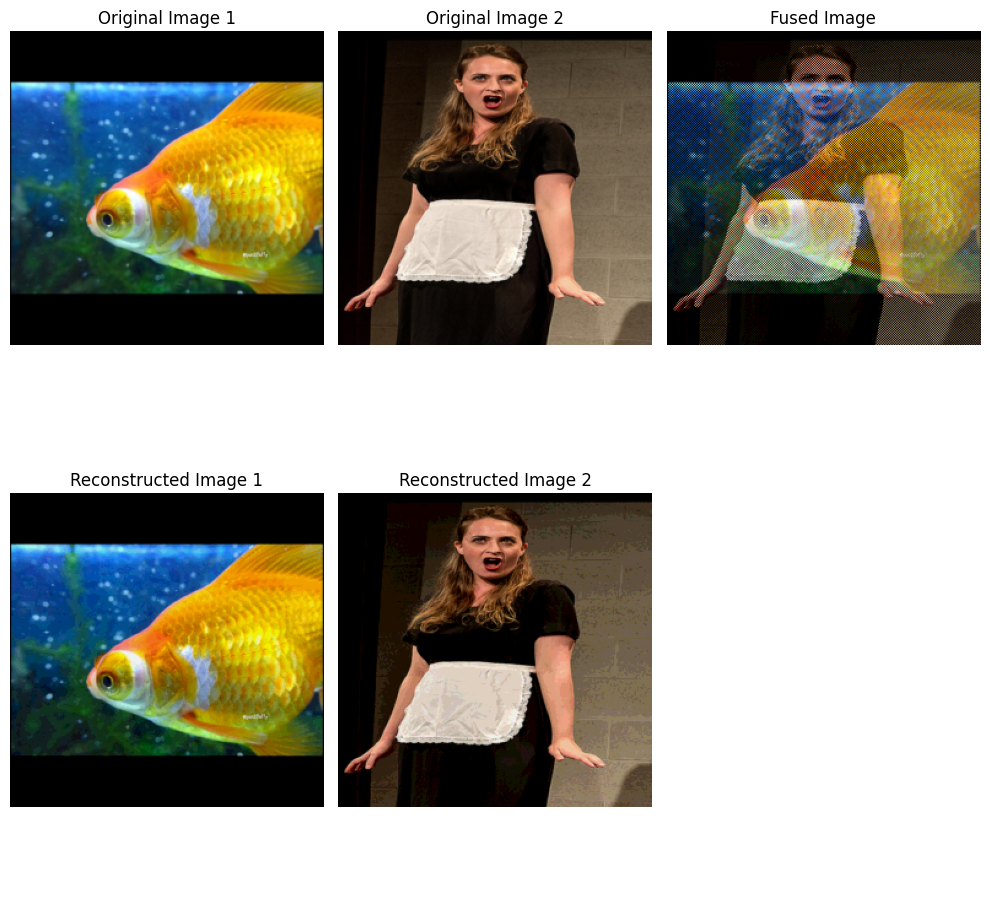

In [17]:
img1_msb = load_image_msb(image_path1)
img2_msb = load_image_msb(image_path2)
fused_image_msb = combine_images_pixel_wise_msb(img1_msb, img2_msb)
img1_reconstructed_msb, img2_reconstructed_msb = reconstruct_images_pixel_wise_msb(fused_image_msb)
fig, axes = plt.subplots(2, 3, figsize=(10, 10))
plot_image(axes[0][0], img1, "Original Image 1")
plot_image(axes[0][1], img2, "Original Image 2")
plot_image(axes[0][2], fused_image_msb, "Fused Image")
plot_image(axes[1][0], img1_reconstructed_msb, "Reconstructed Image 1")
plot_image(axes[1][1], img2_reconstructed_msb, "Reconstructed Image 2")
# Hide the empty subplots
for ax in axes.flat:
    if not ax.has_data():
        ax.axis('off')  # Turn off the axis

plt.tight_layout()
plt.show()

In [18]:
print("LSB Manipulation")
pixel_diff_msb_1 = calculate_mean_pixel_difference(img1, img1_reconstructed_msb/255, absolute=False)
print("Pixel Differences Tensor of image 1:", pixel_diff_msb_1)
absolute_diff_msb_1 = calculate_mean_pixel_difference(img1, img1_reconstructed_msb/255, absolute=True)
print("Absolute Pixel Differences Tensor of image 1:", absolute_diff_msb_1)
pixel_diff_msb_2 = calculate_mean_pixel_difference(img2, img2_reconstructed_msb/255, absolute=False)
print("Pixel Differences Tensor of image 2:", pixel_diff_msb_2)
absolute_diff_msb_2 = calculate_mean_pixel_difference(img2, img2_reconstructed_msb/255, absolute=True)
print("Absolute Pixel Differences Tensor of image 2:", absolute_diff_msb_2)

LSB Manipulation
Pixel Differences Tensor of image 1: 0.0007743132882751524
Absolute Pixel Differences Tensor of image 1: 0.019442467018961906
Pixel Differences Tensor of image 2: 0.0009727355209179223
Absolute Pixel Differences Tensor of image 2: 0.024711275473237038


In [19]:
from tabulate import tabulate

# Gather results in a list format
results = [
    ["Image 1 : Mean Pixel Difference", pixel_diff_4nn_1, pixel_diff_msb_1, pixel_diff_bilinear_1, pixel_diff_bicubic_1, pixel_diff_gaussian_1],
    ["Image 1 : Absolute Pixel Difference", absolute_diff_4nn_1, absolute_diff_msb_1, absolute_diff_bilinear_1, absolute_diff_bicubic_1, absolute_diff_gaussian_1],
    ["Image 2 : Mean Pixel Difference", pixel_diff_4nn_2, pixel_diff_msb_2, pixel_diff_bilinear_2, pixel_diff_bicubic_2, pixel_diff_gaussian_2],
    ["Image 2 : Absolute Pixel Difference", absolute_diff_4nn_2, absolute_diff_msb_2, absolute_diff_bilinear_2, absolute_diff_bicubic_2, absolute_diff_gaussian_2],
]

# Define headers
headers = ["Image", "4NN Refinement", "LSB Manipulation", "Bilinear Refinement", "Bicubic Refinement", "Gaussian Refinement", ]

# Print the table
print(tabulate(results, headers=headers, tablefmt="grid"))

+-------------------------------------+------------------+--------------------+-----------------------+----------------------+-----------------------+
| Image                               |   4NN Refinement |   LSB Manipulation |   Bilinear Refinement |   Bicubic Refinement |   Gaussian Refinement |
+=====================================+==================+====================+=======================+======================+=======================+
| Image 1 : Mean Pixel Difference     |      0.000179317 |        0.000774313 |             0.0484417 |            0.0785725 |             0.0427377 |
+-------------------------------------+------------------+--------------------+-----------------------+----------------------+-----------------------+
| Image 1 : Absolute Pixel Difference |      0.00430128  |        0.0194425   |             0.135292  |            0.135267  |             0.135785  |
+-------------------------------------+------------------+--------------------+---------------

Test for a given directory

In [20]:
import random
import os

def process_images_in_directory(directory_path: str):
    image_files = [os.path.join(directory_path, f) for f in os.listdir(directory_path) if f.endswith(('.jpg', '.jpeg', '.png', 'JPEG'))]
    total_mean_diff_img1_4nn = 0.0
    total_mean_diff_img2_4nn = 0.0
    total_mean_diff_img1_gaussian = 0.0
    total_mean_diff_img2_gaussian = 0.0
    total_mean_diff_img1_msb = 0.0
    total_mean_diff_img2_msb = 0.0
    count = 0

    for i, image_path1 in enumerate(image_files):
        image_path2 = random.choice([img for j, img in enumerate(image_files) if j != i])
        img1, img2 = preprocess_images(image_path1, image_path2)
        combined_image_pixel_wise = combine_images_pixel_wise(img1, img2)
        img1_reconstructed_pixel_wise, img2_reconstructed_pixel_wise = reconstruct_images_pixel_wise(combined_image_pixel_wise)

        img1_NN_refined_pixel_wise_4nn = replace_missing_pixels_with_neighbors(img1_reconstructed_pixel_wise, 1)
        img2_NN_refined_pixel_wise_4nn = replace_missing_pixels_with_neighbors(img2_reconstructed_pixel_wise, 2)
        mean_diff_img1_4nn = calculate_mean_pixel_difference(img1, img1_NN_refined_pixel_wise_4nn)
        mean_diff_img2_4nn = calculate_mean_pixel_difference(img2, img2_NN_refined_pixel_wise_4nn)
        total_mean_diff_img1_4nn += mean_diff_img1_4nn
        total_mean_diff_img2_4nn += mean_diff_img2_4nn

        img1_NN_refined_pixel_wise_gaussian = apply_gaussian_smoothing(img1_reconstructed_pixel_wise, kernel_size=3)
        img2_NN_refined_pixel_wise_gaussian = apply_gaussian_smoothing(img2_reconstructed_pixel_wise, kernel_size=3)
        mean_diff_img1_gaussian = calculate_mean_pixel_difference(img1, img1_NN_refined_pixel_wise_gaussian)
        mean_diff_img2_gaussian = calculate_mean_pixel_difference(img2, img2_NN_refined_pixel_wise_gaussian)
        total_mean_diff_img1_gaussian += mean_diff_img1_gaussian
        total_mean_diff_img2_gaussian += mean_diff_img2_gaussian

        img1_msb = load_image_msb(image_path1)
        img2_msb = load_image_msb(image_path2)
        fused_image_msb = combine_images_pixel_wise_msb(img1_msb, img2_msb)
        img1_reconstructed_msb, img2_reconstructed_msb = reconstruct_images_pixel_wise_msb(fused_image_msb)
        mean_diff_img1_msb = calculate_mean_pixel_difference(img1, img1_reconstructed_msb/255)
        mean_diff_img2_msb = calculate_mean_pixel_difference(img2, img2_reconstructed_msb/255)
        total_mean_diff_img1_msb += mean_diff_img1_msb
        total_mean_diff_img2_msb += mean_diff_img2_msb

        count += 1
        if (count==50):
            break
    
    dataset_mean_diff_img1_4nn = total_mean_diff_img1_4nn / count
    dataset_mean_diff_img2_4nn = total_mean_diff_img2_4nn / count
    dataset_mean_diff_img1_gaussian = total_mean_diff_img1_gaussian / count
    dataset_mean_diff_img2_gaussian = total_mean_diff_img2_gaussian / count
    dataset_mean_diff_img1_msb = total_mean_diff_img1_msb / count
    dataset_mean_diff_img2_msb = total_mean_diff_img2_msb / count
    
    print("Count:", count)
    print("\nFour Nearest Neighbor")
    print("Mean Pixel Difference for Image 1 over Dataset:", dataset_mean_diff_img1_4nn)
    print("Mean Pixel Difference for Image 2 over Dataset:", dataset_mean_diff_img2_4nn)
    print("\nGaussian Smoothing")
    print("Mean Pixel Difference for Image 1 over Dataset:", dataset_mean_diff_img1_gaussian)
    print("Mean Pixel Difference for Image 2 over Dataset:", dataset_mean_diff_img2_gaussian)
    print("\nLSB MAnipulation")
    print("Mean Pixel Difference for Image 1 over Dataset:", dataset_mean_diff_img1_msb)
    print("Mean Pixel Difference for Image 2 over Dataset:", dataset_mean_diff_img2_msb)

# Example directory path
# directory_path = 'E:/4th Year/Research/Dataset/trainA1'
directory_path = '../ImageFuse/clean_images'
process_images_in_directory(directory_path)

KeyboardInterrupt: 

In [ ]:
import random
import os
import torch

def process_images_in_directory(directory_path: str):
    # Set device to GPU if available
    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    
    # List image files
    image_files = [os.path.join(directory_path, f) for f in os.listdir(directory_path) if f.endswith(('.jpg', '.jpeg', '.png', 'JPEG'))]
    
    # Initialize accumulators for mean differences
    total_mean_diff_img1_4nn = 0.0
    total_mean_diff_img2_4nn = 0.0
    total_mean_diff_img1_gaussian = 0.0
    total_mean_diff_img2_gaussian = 0.0
    total_mean_diff_img1_msb = 0.0
    total_mean_diff_img2_msb = 0.0
    count = 0

    for i, image_path1 in enumerate(image_files):
        image_path2 = random.choice([img for j, img in enumerate(image_files) if j != i])
        
        # Load and preprocess images
        img1, img2 = preprocess_images(image_path1, image_path2)  # Ensure this function loads images as tensors on the GPU
        img1, img2 = img1.to(device), img2.to(device)
        
        # Pixel-wise combination and reconstruction
        combined_image_pixel_wise = combine_images_pixel_wise(img1, img2).to(device)
        img1_reconstructed_pixel_wise, img2_reconstructed_pixel_wise = reconstruct_images_pixel_wise(combined_image_pixel_wise)
        
        # Four Nearest Neighbor Refinement
        img1_NN_refined_pixel_wise_4nn = replace_missing_pixels_with_neighbors(img1_reconstructed_pixel_wise, 1).to(device)
        img2_NN_refined_pixel_wise_4nn = replace_missing_pixels_with_neighbors(img2_reconstructed_pixel_wise, 2).to(device)
        mean_diff_img1_4nn = calculate_mean_pixel_difference(img1, img1_NN_refined_pixel_wise_4nn)
        mean_diff_img2_4nn = calculate_mean_pixel_difference(img2, img2_NN_refined_pixel_wise_4nn)
        
        total_mean_diff_img1_4nn += mean_diff_img1_4nn
        total_mean_diff_img2_4nn += mean_diff_img2_4nn

        # Gaussian Smoothing
        img1_NN_refined_pixel_wise_gaussian = apply_gaussian_smoothing(img1_reconstructed_pixel_wise, kernel_size=3).to(device)
        img2_NN_refined_pixel_wise_gaussian = apply_gaussian_smoothing(img2_reconstructed_pixel_wise, kernel_size=3).to(device)
        mean_diff_img1_gaussian = calculate_mean_pixel_difference(img1, img1_NN_refined_pixel_wise_gaussian)
        mean_diff_img2_gaussian = calculate_mean_pixel_difference(img2, img2_NN_refined_pixel_wise_gaussian)
        
        total_mean_diff_img1_gaussian += mean_diff_img1_gaussian
        total_mean_diff_img2_gaussian += mean_diff_img2_gaussian

        # MSB Manipulation
        img1_msb = load_image_msb(image_path1).to(device)
        img2_msb = load_image_msb(image_path2).to(device)
        fused_image_msb = combine_images_pixel_wise_msb(img1_msb, img2_msb).to(device)
        img1_reconstructed_msb, img2_reconstructed_msb = reconstruct_images_pixel_wise_msb(fused_image_msb)
        
        mean_diff_img1_msb = calculate_mean_pixel_difference(img1, img1_reconstructed_msb)
        mean_diff_img2_msb = calculate_mean_pixel_difference(img2, img2_reconstructed_msb)
        
        total_mean_diff_img1_msb += mean_diff_img1_msb
        total_mean_diff_img2_msb += mean_diff_img2_msb

        count += 1
        if count == 10:  # Limit processing to 100 images for this example
            break
    
    # Calculate mean differences across dataset
    dataset_mean_diff_img1_4nn = total_mean_diff_img1_4nn / count
    dataset_mean_diff_img2_4nn = total_mean_diff_img2_4nn / count
    dataset_mean_diff_img1_gaussian = total_mean_diff_img1_gaussian / count
    dataset_mean_diff_img2_gaussian = total_mean_diff_img2_gaussian / count
    dataset_mean_diff_img1_msb = total_mean_diff_img1_msb / count
    dataset_mean_diff_img2_msb = total_mean_diff_img2_msb / count
    
    # Output results
    print("Count:", count)
    print("\nFour Nearest Neighbor")
    print("Mean Pixel Difference for Image 1 over Dataset:", dataset_mean_diff_img1_4nn)
    print("Mean Pixel Difference for Image 2 over Dataset:", dataset_mean_diff_img2_4nn)
    print("\nGaussian Smoothing")
    print("Mean Pixel Difference for Image 1 over Dataset:", dataset_mean_diff_img1_gaussian)
    print("Mean Pixel Difference for Image 2 over Dataset:", dataset_mean_diff_img2_gaussian)
    print("\nMSB Manipulation")
    print("Mean Pixel Difference for Image 1 over Dataset:", dataset_mean_diff_img1_msb)
    print("Mean Pixel Difference for Image 2 over Dataset:", dataset_mean_diff_img2_msb)

# Example usage
directory_path = '../ImageFuse/clean_images'
process_images_in_directory(directory_path)


KeyboardInterrupt: 

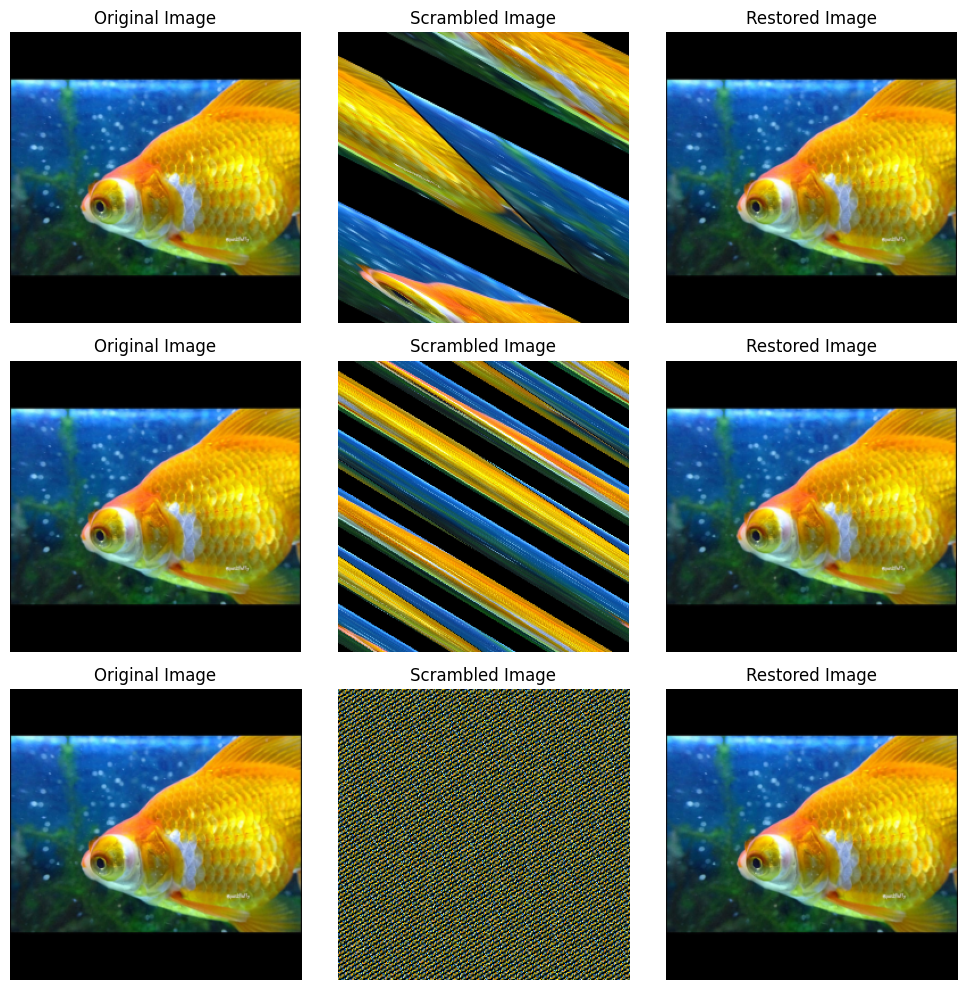

In [ ]:
arnold_const = 2
#Arnold and Revers Arnold
def arnold_transform_tensor(image_tensor: torch.Tensor, iterations: int = 1) -> torch.Tensor:
    N = image_tensor.shape[1]  
    transformed_image = image_tensor.clone()
    for _ in range(iterations):
        new_image = torch.zeros_like(transformed_image)
        for x in range(N):
            for y in range(N):
                x_new = (x + y) % N
                y_new = (x + arnold_const * y) % N
                new_image[:, x_new, y_new] = transformed_image[:, x, y]
        transformed_image = new_image.clone()
    return transformed_image

def reverse_arnold_transform_tensor(image_tensor: torch.Tensor, iterations: int = 1) -> torch.Tensor:
    N = image_tensor.shape[1]  
    transformed_image = image_tensor.clone()
    for _ in range(iterations):
        new_image = torch.zeros_like(transformed_image)
        for x in range(N):
            for y in range(N):
                x_new = (arnold_const * x - y) % N
                y_new = (-x + y) % N
                new_image[:, x_new, y_new] = transformed_image[:, x, y]
        transformed_image = new_image.clone()
    return transformed_image

scrambled_image_1 = arnold_transform_tensor(img1, 1)
restored_image_1 = reverse_arnold_transform_tensor(scrambled_image_1, 1)
scrambled_image_2 = arnold_transform_tensor(img1, 2)
restored_image_2 = reverse_arnold_transform_tensor(scrambled_image_2, 2)
scrambled_image_8 = arnold_transform_tensor(img1, 8)
restored_image_8 = reverse_arnold_transform_tensor(scrambled_image_8, 8)

fig, axes = plt.subplots(3, 3, figsize=(10, 10))
plot_image(axes[0][0], img1, "Original Image")
plot_image(axes[0][1], scrambled_image_1, "Scrambled Image")
plot_image(axes[0][2], restored_image_1, "Restored Image")
plot_image(axes[1][0], img1, "Original Image")
plot_image(axes[1][1], scrambled_image_2, "Scrambled Image")
plot_image(axes[1][2], restored_image_2, "Restored Image")
plot_image(axes[2][0], img1, "Original Image")
plot_image(axes[2][1], scrambled_image_8, "Scrambled Image")
plot_image(axes[2][2], restored_image_8, "Restored Image")

plt.tight_layout()
plt.show()

In [ ]:
import torch
import torch.nn.functional as F

# Function to add Gaussian noise
def add_gaussian_noise(image_tensor: torch.Tensor, mean: float = 0, std: float = 0.1) -> torch.Tensor:
    noise = torch.randn_like(image_tensor) * std + mean
    noisy_image = image_tensor + noise
    return noisy_image

# Denoising function using Gaussian kernel
def denoise_image(image_tensor: torch.Tensor, std: float = 0.1) -> torch.Tensor:
    kernel_size = 5
    # Generate the 1D Gaussian kernel
    kernel = torch.exp(-0.5 * torch.arange(-(kernel_size // 2), (kernel_size // 2) + 1).float() ** 2 / std ** 2)
    kernel = kernel / kernel.sum()  # Normalize kernel
    kernel = kernel.view(1, 1, -1)  # 1D kernel
    
    # Expand the kernel to 3 channels (RGB)
    kernel = kernel.expand(3, 1, kernel_size)  # Make kernel compatible for RGB images
    
    # Apply convolution
    image_tensor = image_tensor.unsqueeze(0)  # Add batch dimension (1, 3, 256, 256)
    denoised_image = F.conv2d(image_tensor, kernel, padding=kernel_size // 2, groups=image_tensor.size(1), stride=1)  # stride=1 is a single integer
    
    return denoised_image.squeeze(0)  # Remove batch dimension

# Example usage:
# img1 = torch.rand(3, 256, 256)  # Example image tensor (random for demonstration)

# Add Gaussian noise
noisy_image_1 = add_gaussian_noise(img1, mean=0, std=0.1)

# Denoise the noisy image (reverse step)
denoised_image_1 = denoise_image(noisy_image_1, std=0.1)


RuntimeError: expected stride to be a single integer value or a list of 1 values to match the convolution dimensions, but got stride=[1, 1]

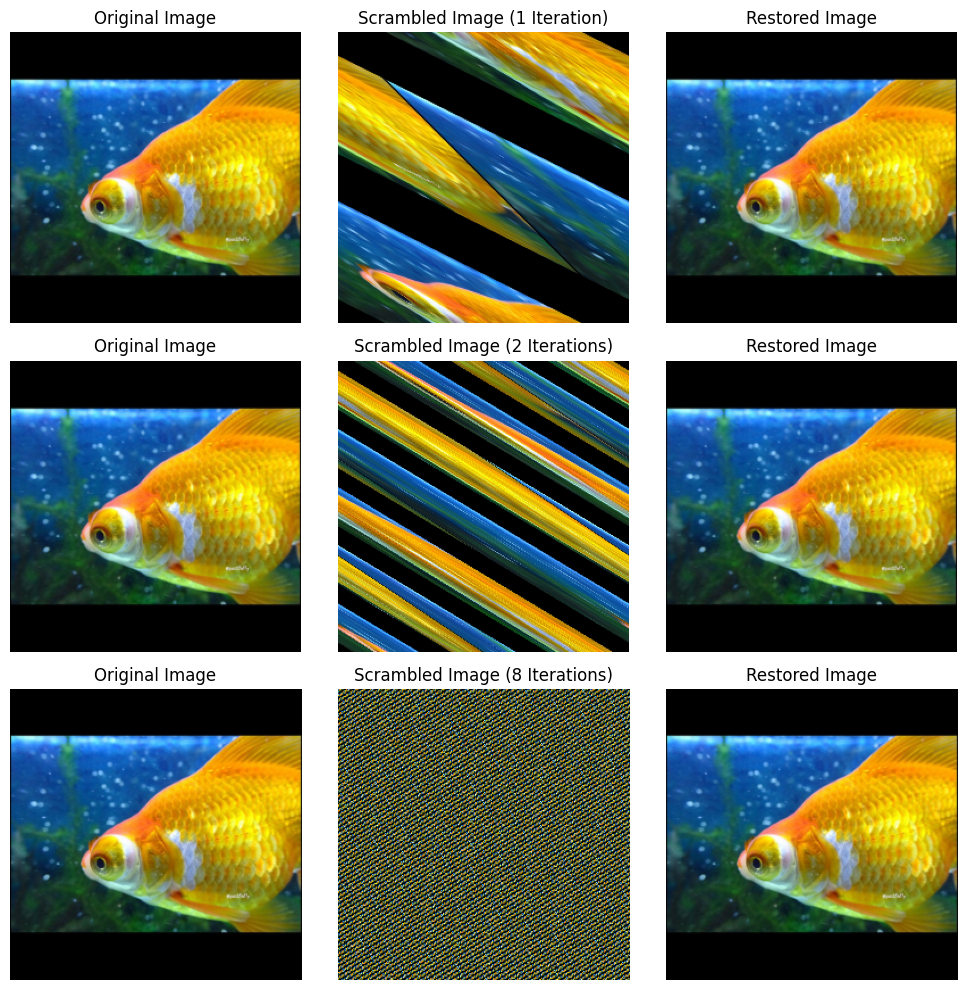

In [ ]:
fig, axes = plt.subplots(3, 3, figsize=(10, 10))

# Row 1: Scrambled Image with 1 Iteration
plot_image(axes[0][0], img1, "")
plot_image(axes[0][1], scrambled_image_1, "")
plot_image(axes[0][2], restored_image_1, "")
axes[0][0].set_title("Original Image")
axes[0][1].set_title("Scrambled Image (1 Iteration)")
axes[0][2].set_title("Restored Image")

# Row 2: Scrambled Image with 2 Iterations
plot_image(axes[1][0], img1, "")
plot_image(axes[1][1], scrambled_image_2, "")
plot_image(axes[1][2], restored_image_2, "")
axes[1][0].set_title("Original Image")
axes[1][1].set_title("Scrambled Image (2 Iterations)")
axes[1][2].set_title("Restored Image")

# Row 3: Scrambled Image with 8 Iterations
plot_image(axes[2][0], img1, "")
plot_image(axes[2][1], scrambled_image_8, "")
plot_image(axes[2][2], restored_image_8, "")
axes[2][0].set_title("Original Image")
axes[2][1].set_title("Scrambled Image (8 Iterations)")
axes[2][2].set_title("Restored Image")

plt.tight_layout()
plt.show()


##Bit Plane Slicing


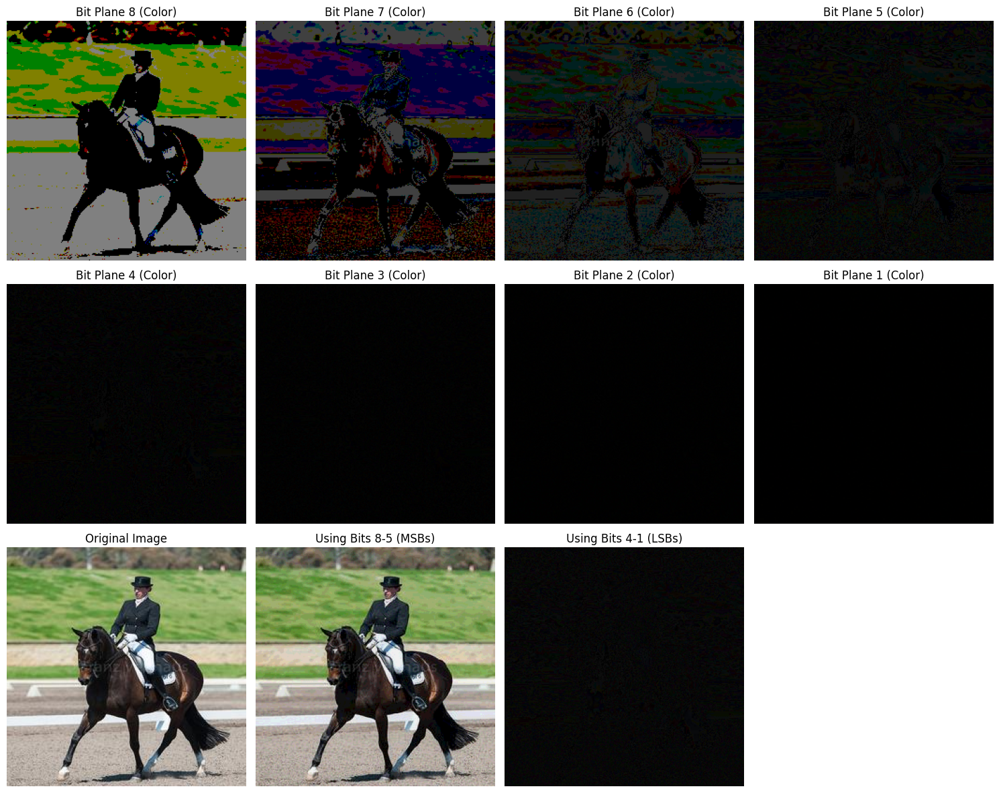

In [ ]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

def split_into_bit_planes(image):
    """Splits an RGB image into 8 bit planes for each channel."""
    bit_planes = []
    for channel in range(3):  # For R, G, B channels
        planes = []
        for bit in range(8):
            planes.append((image[:, :, channel] >> bit) & 1)  # Extract each bit plane
        bit_planes.append(planes)
    return bit_planes

def reconstruct_from_bit_planes(bit_planes, bit_indices):
    """Reconstructs an image using specific bit planes."""
    reconstructed_image = np.zeros_like(image, dtype=np.uint8)
    for channel in range(3):  # For R, G, B channels
        for bit in bit_indices:
            reconstructed_image[:, :, channel] += (bit_planes[channel][bit] * (1 << bit))
    return reconstructed_image

# Load an example RGB image
image_path = './original_images/ILSVRC2017_test_00000034.JPEG'  # Replace with your image path
image = cv2.imread(image_path)
image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

# Split the image into 8 bit planes
bit_planes = split_into_bit_planes(image)

# Create 8 separate color images for bit planes
bit_plane_images_color = []
for bit in range(8):
    bit_plane_image = np.zeros_like(image, dtype=np.uint8)
    for channel in range(3):  # Combine bit planes across channels
        bit_plane_image[:, :, channel] = bit_planes[channel][bit] * (1 << bit)
    bit_plane_images_color.append(bit_plane_image)

# Reconstruct the image using only MSBs (8th to 5th bits)
msb_image = reconstruct_from_bit_planes(bit_planes, range(4, 8))

# Reconstruct the image using only LSBs (4th to 1st bits)
lsb_image = reconstruct_from_bit_planes(bit_planes, range(0, 4))

# Plotting
fig, axes = plt.subplots(3, 4, figsize=(15, 12))

# Top row: Individual bit planes (8-5)
for i in range(4):
    axes[0, i].imshow(bit_plane_images_color[7 - i])
    axes[0, i].set_title(f'Bit Plane {8 - i} (Color)')
    axes[0, i].axis('off')

# Middle row: Individual bit planes (4-1)
for i in range(4):
    axes[1, i].imshow(bit_plane_images_color[3 - i])
    axes[1, i].set_title(f'Bit Plane {4 - i} (Color)')
    axes[1, i].axis('off')

# Bottom row: Reconstructed images
axes[2, 0].imshow(image)
axes[2, 0].set_title('Original Image')
axes[2, 0].axis('off')

axes[2, 1].imshow(msb_image)
axes[2, 1].set_title('Using Bits 8-5 (MSBs)')
axes[2, 1].axis('off')

axes[2, 2].imshow(lsb_image)
axes[2, 2].set_title('Using Bits 4-1 (LSBs)')
axes[2, 2].axis('off')

axes[2, 3].axis('off')  # Leave one subplot empty

plt.tight_layout()
plt.show()
